In [1]:
%reload_ext autoreload
%autoreload 2
%matplotlib inline

In [2]:
from fastai import *
from fastai_audio import *

In [13]:
from itertools import islice
from IPython.display import Audio
import librosa

In [95]:
from utils import read_file, write_file

In [5]:
DATA = Path('data')
AUDIO = DATA/'freesound/audio_22050_trimmed/train'

In [7]:
files = list(islice(AUDIO.iterdir(), 10))
files

[PosixPath('data/freesound/audio_22050_trimmed/train/0f2ab678.wav'),
 PosixPath('data/freesound/audio_22050_trimmed/train/4fd883bb.wav'),
 PosixPath('data/freesound/audio_22050_trimmed/train/2137ed0e.wav'),
 PosixPath('data/freesound/audio_22050_trimmed/train/d5fc9f70.wav'),
 PosixPath('data/freesound/audio_22050_trimmed/train/3788e6ce.wav'),
 PosixPath('data/freesound/audio_22050_trimmed/train/910dc153.wav'),
 PosixPath('data/freesound/audio_22050_trimmed/train/feadb031.wav'),
 PosixPath('data/freesound/audio_22050_trimmed/train/1f095666.wav'),
 PosixPath('data/freesound/audio_22050_trimmed/train/4f5b430d.wav'),
 PosixPath('data/freesound/audio_22050_trimmed/train/5d946c59.wav')]

In [10]:
fn = str(files[0])
Audio(fn)

In [11]:
x, sr = read_file(fn)
x.shape, sr

((41013,), 22050)

## STFT

(1025, 161)


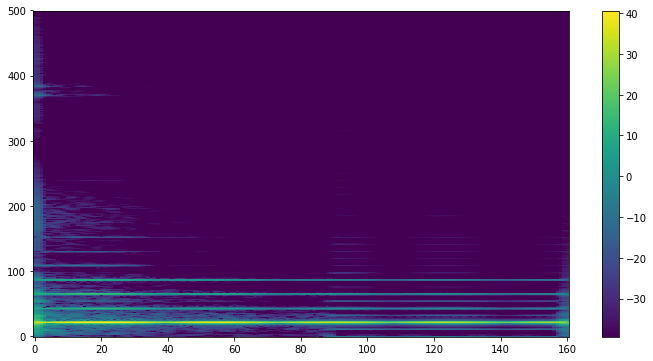

In [21]:
X = librosa.stft(x, n_fft=2048, hop_length=256, pad_mode='constant')
mX = librosa.amplitude_to_db(abs(X))
print(mX.shape)
plt.figure(figsize=(12, 6))
plt.imshow(mX[:500, :], aspect='auto', origin='lower')
plt.colorbar()

### time stretch

In [22]:
x_ts = librosa.effects.time_stretch(x, 1.5)
print(x_ts.shape)

(27136,)


(1025, 107)


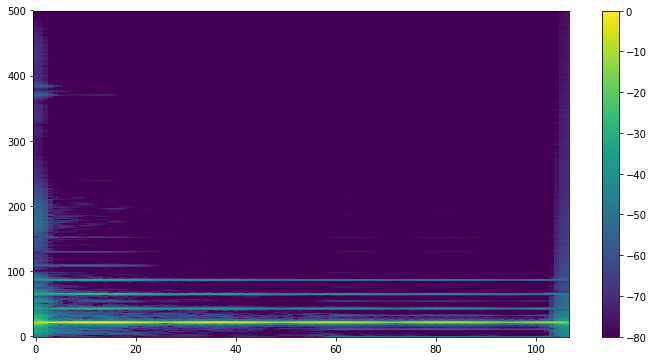

In [43]:
X = librosa.stft(x_ts, n_fft=2048, hop_length=256, pad_mode='constant')
mX1 = librosa.amplitude_to_db(abs(X), ref=np.max)
print(mX1.shape)
plt.figure(figsize=(12, 6))
plt.imshow(mX1[:500, :], aspect='auto', origin='lower')
plt.colorbar()

(1025, 107)


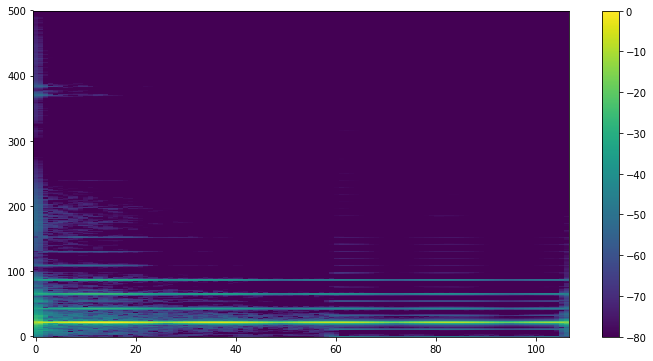

In [44]:
X = librosa.stft(x, n_fft=2048, hop_length=int(256*1.5), pad_mode='constant')
mX2 = librosa.amplitude_to_db(abs(X), ref=np.max)
print(mX2.shape)
plt.figure(figsize=(12, 6))
plt.imshow(mX2[:500, :], aspect='auto', origin='lower')
plt.colorbar()

In [45]:
d = mX1 - mX2

In [46]:
abs_d = abs(d)

In [47]:
d.min(), d.max(), d.mean(), d.std()

(-25.636955, 35.554237, 0.061484396, 1.7212284)

In [48]:
abs_d.min(), abs_d.max(), abs_d.mean(), abs_d.std()

(0.0, 35.554237, 0.38523358, 1.6786908)

### pitch shift

In [56]:
x_ps = librosa.effects.pitch_shift(x, sr=sr, n_steps=2)
x_ps.shape

(41013,)

In [57]:
Audio(x, rate=sr)

In [58]:
Audio(x_ps, rate=sr)

(1025, 161) (1025, 161)


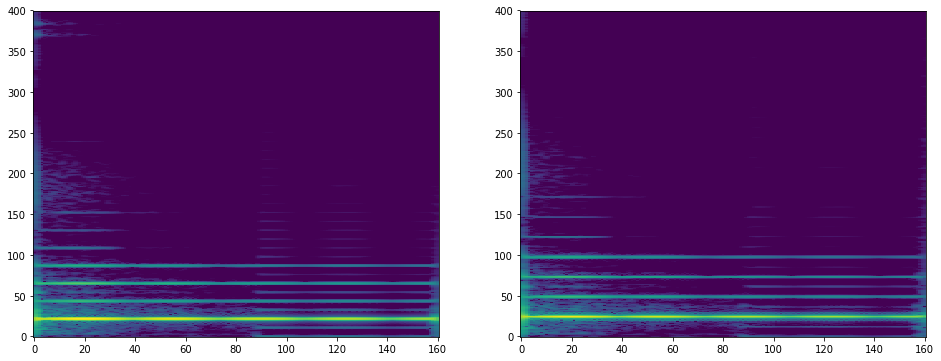

In [64]:
X    = librosa.stft(x,    n_fft=2048, hop_length=256, pad_mode='constant')
X_ps = librosa.stft(x_ps, n_fft=2048, hop_length=256, pad_mode='constant')


mX    = librosa.amplitude_to_db(abs(X),    ref=np.max)
mX_ps = librosa.amplitude_to_db(abs(X_ps), ref=np.max)
print(mX.shape, mX_ps.shape)

fig, ax = plt.subplots(1, 2, figsize=(16, 6))

ax[0].imshow(mX   [:400, :], aspect='auto', origin='lower')
ax[1].imshow(mX_ps[:400, :], aspect='auto', origin='lower')

## mel spectrogram

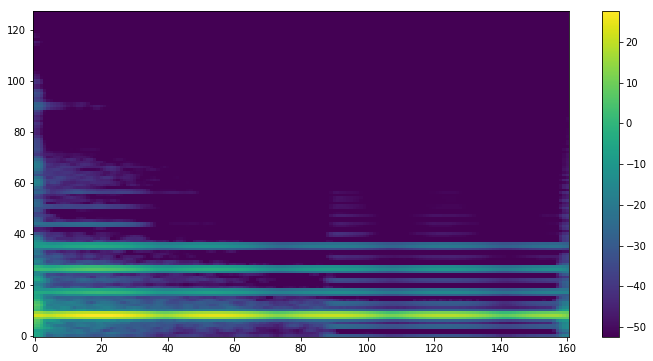

In [50]:
X = librosa.feature.melspectrogram(x, sr=sr, n_fft=2048, hop_length=256, n_mels=128)
db = librosa.power_to_db(X)
plt.figure(figsize=(12, 6))
plt.imshow(db, aspect='auto', origin='lower')
plt.colorbar()

### time stretch

(128, 107)


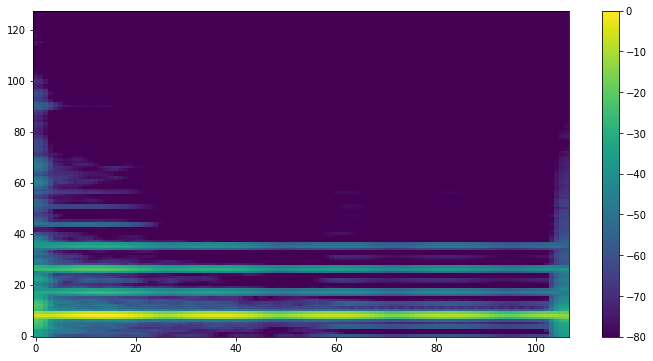

In [54]:
X = librosa.feature.melspectrogram(x_ts, sr=sr, n_fft=2048, hop_length=256, n_mels=128)
db1 = librosa.power_to_db(X, ref=np.max)
print(db1.shape)
plt.figure(figsize=(12, 6))
plt.imshow(db1, aspect='auto', origin='lower')
plt.colorbar()

(128, 107)


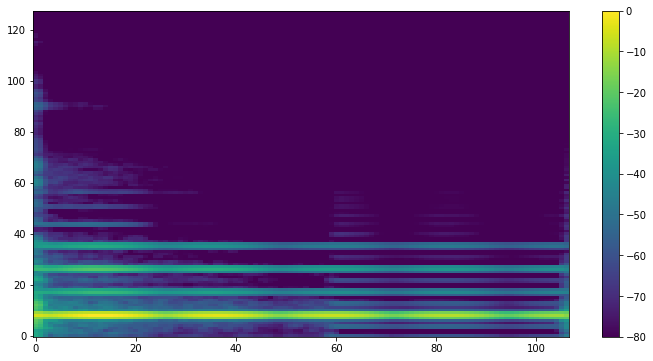

In [55]:
X = librosa.feature.melspectrogram(x, sr=sr, n_fft=2048, hop_length=int(256 * 1.5), n_mels=128)
db2 = librosa.power_to_db(X, ref=np.max)
print(db2.shape)
plt.figure(figsize=(12, 6))
plt.imshow(db2, aspect='auto', origin='lower')
plt.colorbar()

In [71]:
fn = files[0]
src_path = fn.parent
dst_path = Path('.')

In [77]:
fn.stem

'0f2ab678'

In [91]:
class RandomPitchShift():
    def __init__(self, sample_rate=22050, max_steps=3):
        self.sample_rate = sample_rate
        self.max_steps = max_steps
    def __call__(self, x):
        n_steps = np.random.uniform(-self.max_steps, self.max_steps)
        x = librosa.effects.pitch_shift(x, sr=self.sample_rate, n_steps=n_steps)
        return x

In [92]:
from IPython.display import display

In [103]:
max_steps=3
pitch_shifter = RandomPitchShift(sample_rate=22050, max_steps=3)
    
def _make_transforms(filename, src_path, dst_path, tfm_fn, sample_rate=22050, n_tfms=5):
    data, sr = read_file(filename, path=src_path)
    fn = Path(filename)
    # copy original file 
    new_fn = fn.stem + '_00.wav'
    write_file(data, new_fn, path=dst_path, sample_rate=sample_rate)
    # make n_tfms modified files
    for i in range(n_tfms):
        new_fn = fn.stem + '_{:02d}'.format(i+1) + '.wav'
        x = tfm_fn(data)
        write_file(x, new_fn, path=dst_path, sample_rate=sample_rate)
    

In [104]:
_make_transforms(fname, src_path, dst_path, pitch_shifter)

In [105]:
fns = [f for f in dst_path.iterdir() if f.suffix == '.wav']; fns

[PosixPath('0f2ab678_04.wav'),
 PosixPath('0f2ab678_05.wav'),
 PosixPath('0f2ab678_02.wav'),
 PosixPath('0f2ab678_03.wav'),
 PosixPath('0f2ab678_01.wav'),
 PosixPath('0f2ab678_00.wav')]

In [106]:
for f in fns:
    display(Audio(str(f), rate=sr))

In [112]:
src_ex = Path('data/examples_mono')
src_ex.exists()

True

In [113]:
dst_ex = Path('data/examples_tfms')

In [114]:
from utils import pitch_shift_path

In [119]:
sr

22050

In [121]:
pitch_shift_path(src_ex, dst_ex, 3, 44100)

pitch shift 44100


sample rate _make 44100
sample rate _make 44100
sample rate _make 44100



In [122]:
fns = [f for f in dst_ex.iterdir() if f.suffix == '.wav']; fns

[PosixPath('data/examples_tfms/sunshine_riff_04.wav'),
 PosixPath('data/examples_tfms/sunshine_riff_05.wav'),
 PosixPath('data/examples_tfms/sunshine_riff_02.wav'),
 PosixPath('data/examples_tfms/sunshine_riff_03.wav'),
 PosixPath('data/examples_tfms/sunshine_riff_01.wav'),
 PosixPath('data/examples_tfms/sunshine_riff_00.wav'),
 PosixPath('data/examples_tfms/e_major_chord_01.wav'),
 PosixPath('data/examples_tfms/e_octaves_00.wav'),
 PosixPath('data/examples_tfms/e_octaves_01.wav'),
 PosixPath('data/examples_tfms/e_major_chord_00.wav'),
 PosixPath('data/examples_tfms/e_major_chord_02.wav'),
 PosixPath('data/examples_tfms/e_octaves_03.wav'),
 PosixPath('data/examples_tfms/e_octaves_02.wav'),
 PosixPath('data/examples_tfms/e_major_chord_03.wav'),
 PosixPath('data/examples_tfms/e_major_chord_04.wav'),
 PosixPath('data/examples_tfms/e_octaves_05.wav'),
 PosixPath('data/examples_tfms/e_octaves_04.wav'),
 PosixPath('data/examples_tfms/e_major_chord_05.wav')]

In [123]:
for f in fns:
    print(f)
    display(Audio(str(f), rate=sr))

data/examples_tfms/sunshine_riff_04.wav


data/examples_tfms/sunshine_riff_05.wav


data/examples_tfms/sunshine_riff_02.wav


data/examples_tfms/sunshine_riff_03.wav


data/examples_tfms/sunshine_riff_01.wav


data/examples_tfms/sunshine_riff_00.wav


data/examples_tfms/e_major_chord_01.wav


data/examples_tfms/e_octaves_00.wav


data/examples_tfms/e_octaves_01.wav


data/examples_tfms/e_major_chord_00.wav


data/examples_tfms/e_major_chord_02.wav


data/examples_tfms/e_octaves_03.wav


data/examples_tfms/e_octaves_02.wav


data/examples_tfms/e_major_chord_03.wav


data/examples_tfms/e_major_chord_04.wav


data/examples_tfms/e_octaves_05.wav


data/examples_tfms/e_octaves_04.wav


data/examples_tfms/e_major_chord_05.wav
